# Airbnb European Cities - EDA, Modelling and Model Employment

In [162]:
import pandas as pd
import os
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import numpy as np
from geopy.distance import great_circle
from geopy.geocoders import Nominatim
from sklearn.decomposition import PCA
from sklearn.utils import shuffle
import requests

#### Importing datasets and merging them into an overall dataset for all cities

In [52]:
data_dir = r'C:\My Files\DSProjects\JupyterNotebooks\Final Project\Airbnb Europe Cities\Dataset'
datasets = os.listdir(data_dir)
datasets

['amsterdam_weekdays.csv',
 'amsterdam_weekends.csv',
 'athens_weekdays.csv',
 'athens_weekends.csv',
 'barcelona_weekdays.csv',
 'barcelona_weekends.csv',
 'berlin_weekdays.csv',
 'berlin_weekends.csv',
 'budapest_weekdays.csv',
 'budapest_weekends.csv',
 'lisbon_weekdays.csv',
 'lisbon_weekends.csv',
 'london_weekdays.csv',
 'london_weekends.csv',
 'paris_weekdays.csv',
 'paris_weekends.csv',
 'rome_weekdays.csv',
 'rome_weekends.csv',
 'vienna_weekdays.csv',
 'vienna_weekends.csv']

In [53]:
datasets[0].split('_')[0]

'amsterdam'

In [54]:
datasets[0].split('_')[1].split('.')[0]

'weekdays'

In [55]:
df = pd.DataFrame()
for dataset in datasets:
    file_path = os.path.join(data_dir, dataset)
    globals()[f"{dataset}"] = pd.read_csv(file_path)    
    globals()[f"{dataset}"]['city'] = dataset.split('_')[0]
    globals()[f"{dataset}"]['week_time'] = dataset.split('_')[1].split('.')[0]
    df = pd.concat([df , globals()[f"{dataset}"]])

df.reset_index(inplace = True)

    

### Data Cleaning and Feature Engineering

In [56]:
df.head()

,index,Unnamed: 0,realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,...,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,city,week_time
0,0,0,194.033698,Private room,False,True,2.0,False,1,0,...,5.022964,2.539380,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,amsterdam,weekdays
1,1,1,344.245776,Private room,False,True,4.0,False,0,0,...,0.488389,0.239404,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,amsterdam,weekdays
2,2,2,264.101422,Private room,False,True,2.0,False,0,1,...,5.748312,3.651621,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,amsterdam,weekdays
3,3,3,433.529398,Private room,False,True,4.0,False,0,1,...,0.384862,0.439876,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,amsterdam,weekdays
4,4,4,485.552926,Private room,False,True,2.0,True,0,0,...,0.544738,0.318693,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,amsterdam,weekdays


In [57]:
# Dropping Unnamed Column and renaming some columns
df.drop(['Unnamed: 0', 'index', 'attr_index', 'rest_index'], axis = 1, inplace = True)
df.rename(columns={'realSum': 'price', 'biz' : 'is_bis', 'multi' : 'multi_rooms', 'host_is_superhost' : 'is_superhost', 'dist' : 'dist_centre'}, inplace = True)

In [58]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51707 entries, 0 to 51706
Data columns (total 19 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   price                       51707 non-null  float64
 1   room_type                   51707 non-null  object 
 2   room_shared                 51707 non-null  bool   
 3   room_private                51707 non-null  bool   
 4   person_capacity             51707 non-null  float64
 5   is_superhost                51707 non-null  bool   
 6   multi_rooms                 51707 non-null  int64  
 7   is_bis                      51707 non-null  int64  
 8   cleanliness_rating          51707 non-null  float64
 9   guest_satisfaction_overall  51707 non-null  float64
 10  bedrooms                    51707 non-null  int64  
 11  dist_centre                 51707 non-null  float64
 12  metro_dist                  51707 non-null  float64
 13  attr_index_norm             517

#### Features Explanation:
1. **price**: The total price of the listing.
2. **room_type**: Type of room (private/shared/entire home/apt).
3. **is_superhost**: Boolean value indicating if the host is a superhost or not.
4. **multi**: Indicator whether the listing is for multiple rooms or not.
5. **is_bis**: Boolean value indicating if the listing is business-purposed or not.
6. **guest_satisfaction_overall**: Overall rating from guests comparing all listings offered by the host.
7. **bedrooms**: Number of bedrooms.
8. **dist_centre**: Distance from the city center.
9. **metro_dist**: Distance from the nearest metro.
10. **attr_index** and **attr_index_norm**: Index demonstrating how near the listing is to city attractions, with the norm being the same but normalized from 0 to 100.
11. **rest_index** and **rest_index_norm**: Index demonstrating how near the listing is to restaurants, with the norm being the same but normalized from 0 to 100.
12. **lng** & **lat** coordinates: For location identification.
13. **city**: City name.
14. **week_time**: Weekday or Weekend.

#### Inspecting unqiue values in each column to address any odd values

In [59]:
for column in df.columns:
    print(f'{column} column unique values are :\n\n {df[column].unique()} \n\n')

price column unique values are :

 [194.03369812 344.24577602 264.10142245 ... 715.93857373 637.16896898
 301.05415702] 


room_type column unique values are :

 ['Private room' 'Entire home/apt' 'Shared room'] 


room_shared column unique values are :

 [False  True] 


room_private column unique values are :

 [ True False] 


person_capacity column unique values are :

 [2. 4. 3. 6. 5.] 


is_superhost column unique values are :

 [False  True] 


multi_rooms column unique values are :

 [1 0] 


is_bis column unique values are :

 [0 1] 


cleanliness_rating column unique values are :

 [10.  8.  9.  6.  7.  5.  4.  2.  3.] 


guest_satisfaction_overall column unique values are :

 [ 93.  85.  87.  90.  98. 100.  94.  96.  88.  97.  95.  89.  91.  84.
  77.  99.  80.  92.  82.  78.  86.  74.  81.  83.  73.  76.  75.  70.
  65.  47.  60.  20.  40.  72.  79.  68.  57.  56.  67.  50.  53.  63.
  71.  66.  64.  69.  62.  30.  44.  46.  55.  61.  54.] 


bedrooms column unique values ar

#### It seems that no non-normal values exist in any column

In [60]:
df.describe()

,price,person_capacity,multi_rooms,is_bis,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist_centre,metro_dist,attr_index_norm,rest_index_norm,lng,lat
count,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.00000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000
mean,279.879591,3.161661,0.291353,0.350204,9.390624,92.628232,1.15876,3.191285,0.681540,13.423792,22.786177,7.426068,45.671128
std,327.948386,1.298545,0.454390,0.477038,0.954868,8.945531,0.62741,2.393803,0.858023,9.807985,17.804096,9.799725,5.249263
min,34.779339,2.000000,0.000000,0.000000,2.000000,20.000000,0.00000,0.015045,0.002301,0.926301,0.592757,-9.226340,37.953000
25%,148.752174,2.000000,0.000000,0.000000,9.000000,90.000000,1.00000,1.453142,0.248480,6.380926,8.751480,-0.072500,41.399510
50%,211.343089,3.000000,0.000000,0.000000,10.000000,95.000000,1.00000,2.613538,0.413269,11.468305,17.542238,4.873000,47.506690
75%,319.694287,4.000000,1.000000,1.000000,10.000000,99.000000,1.00000,4.263077,0.737840,17.415082,32.964603,13.518825,51.471885
max,18545.450285,6.000000,1.000000,1.000000,10.000000,100.000000,10.00000,25.284557,14.273577,100.000000,100.000000,23.786020,52.641410


###
### Notes on the numerical describe method :
    1 - Price has odd max value
    2- Bedrooms max value is 10
    3- attr_index_norm and rest_index_norm, is the same values of the rest and attr columns but normalized from 0 to 100
###

In [61]:
df['price'].sort_values()

15563       34.779339
13884       37.129295
13954       39.009259
15917       40.184236
3948        42.884259
             ...     
50787    13656.358834
48380    13664.305916
24348    15499.894165
34803    16445.614689
3590     18545.450285
Name: price, Length: 51707, dtype: float64

#### It's not a wrong value but it's an outlier.
#### We will later generate a copy of the dataframe withour outliers to compare the performance of the models with and withour the outliers, but first we will deal with the data in its original state and gather some insights with visulization

In [62]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51707 entries, 0 to 51706
Data columns (total 19 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   price                       51707 non-null  float64
 1   room_type                   51707 non-null  object 
 2   room_shared                 51707 non-null  bool   
 3   room_private                51707 non-null  bool   
 4   person_capacity             51707 non-null  float64
 5   is_superhost                51707 non-null  bool   
 6   multi_rooms                 51707 non-null  int64  
 7   is_bis                      51707 non-null  int64  
 8   cleanliness_rating          51707 non-null  float64
 9   guest_satisfaction_overall  51707 non-null  float64
 10  bedrooms                    51707 non-null  int64  
 11  dist_centre                 51707 non-null  float64
 12  metro_dist                  51707 non-null  float64
 13  attr_index_norm             517

In [63]:
df.head()

,price,room_type,room_shared,room_private,person_capacity,is_superhost,multi_rooms,is_bis,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist_centre,metro_dist,attr_index_norm,rest_index_norm,lng,lat,city,week_time
0,194.033698,Private room,False,True,2.0,False,1,0,10.0,93.0,1,5.022964,2.539380,4.166708,6.846473,4.90569,52.41772,amsterdam,weekdays
1,344.245776,Private room,False,True,4.0,False,0,0,8.0,85.0,1,0.488389,0.239404,33.421209,58.342928,4.90005,52.37432,amsterdam,weekdays
2,264.101422,Private room,False,True,2.0,False,0,1,9.0,87.0,1,5.748312,3.651621,3.985908,6.646700,4.97512,52.36103,amsterdam,weekdays
3,433.529398,Private room,False,True,4.0,False,0,1,9.0,90.0,2,0.384862,0.439876,26.119108,60.973565,4.89417,52.37663,amsterdam,weekdays
4,485.552926,Private room,False,True,2.0,True,0,0,10.0,98.0,1,0.544738,0.318693,29.272733,56.811677,4.90051,52.37508,amsterdam,weekdays


## Feature Engineering

### New proposed features:
    1- Price per person 
    2- Distance Category : Categorization of listing distance to metro and city center
    3- Categroziation of price : High - Average - Low compared to city average, we can use this feature to apply classification techniques ( we will generate this feature after outliers handling )

In [64]:
#Price per person
df['price_per_pers'] = df['price'] / df['person_capacity']

In [65]:
#Categorication of price per city
city_avg_price = df.groupby('city')['price'].mean()
city_avg_price

city
amsterdam    573.112795
athens       151.744121
barcelona    293.753706
berlin       244.583752
budapest     176.513548
lisbon       238.210479
london       362.469256
paris        392.531403
rome         205.391950
vienna       241.582484
Name: price, dtype: float64

In [66]:
#near_far index
def dist_cat(row):

    if row['metro_dist'] >= 1 and row['dist_centre'] >= 2 :
        return 'Metro far , Center far'
    elif row['metro_dist'] < 1 and row['dist_centre'] >= 2 :
        return 'Metro near , Center far'
    elif row['metro_dist'] >= 1 and row['dist_centre'] < 2 :
        return 'Metro far , Center near'
    else :
        return 'Metro near, Center near'

In [67]:
df['distance_category'] = df.apply(lambda row : dist_cat(row), axis = 1)

In [68]:
df

,price,room_type,room_shared,room_private,person_capacity,is_superhost,multi_rooms,is_bis,cleanliness_rating,guest_satisfaction_overall,...,dist_centre,metro_dist,attr_index_norm,rest_index_norm,lng,lat,city,week_time,price_per_pers,distance_category
0,194.033698,Private room,False,True,2.0,False,1,0,10.0,93.0,...,5.022964,2.539380,4.166708,6.846473,4.90569,52.41772,amsterdam,weekdays,97.016849,"Metro far , Center far"
1,344.245776,Private room,False,True,4.0,False,0,0,8.0,85.0,...,0.488389,0.239404,33.421209,58.342928,4.90005,52.37432,amsterdam,weekdays,86.061444,"Metro near, Center near"
2,264.101422,Private room,False,True,2.0,False,0,1,9.0,87.0,...,5.748312,3.651621,3.985908,6.646700,4.97512,52.36103,amsterdam,weekdays,132.050711,"Metro far , Center far"
3,433.529398,Private room,False,True,4.0,False,0,1,9.0,90.0,...,0.384862,0.439876,26.119108,60.973565,4.89417,52.37663,amsterdam,weekdays,108.382349,"Metro near, Center near"
4,485.552926,Private room,False,True,2.0,True,0,0,10.0,98.0,...,0.544738,0.318693,29.272733,56.811677,4.90051,52.37508,amsterdam,weekdays,242.776463,"Metro near, Center near"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51702,715.938574,Entire home/apt,False,False,6.0,False,0,1,10.0,100.0,...,0.530181,0.135447,15.712158,10.604584,16.37940,48.21136,vienna,weekends,119.323096,"Metro near, Center near"
51703,304.793960,Entire home/apt,False,False,2.0,False,0,0,8.0,86.0,...,0.810205,0.100839,14.678608,8.270427,16.38070,48.20296,vienna,weekends,152.396980,"Metro near, Center near"
51704,637.168969,Entire home/apt,False,False,2.0,False,0,0,10.0,93.0,...,0.994051,0.202539,12.107921,6.822996,16.38568,48.20460,vienna,weekends,318.584484,"Metro near, Center near"
51705,301.054157,Private room,False,True,2.0,False,0,0,10.0,87.0,...,3.044100,0.287435,7.822803,3.832416,16.34100,48.19200,vienna,weekends,150.527079,"Metro near , Center far"


### Exploratory Data Analysis and Visulisation:

1- Price Distribution Across Cities: Plotting boxplots or violin plots of prices across cities to observe price distribution and compare median prices.

In [69]:
pd.pivot_table(data = df, index = ['city'], columns = ['week_time'], values = ['price'], aggfunc= 'mean' )

price            
week_time    weekdays    weekends
city                             
amsterdam  545.020526  604.828018
athens     155.866982  147.580456
barcelona  288.391667  300.277940
berlin     240.220422  249.252516
budapest   168.429367  185.120628
lisbon     236.345459  240.044051
london     360.230348  364.389747
paris      398.786678  387.028589
rome       201.618053  209.130063
vienna     240.384834  242.739524

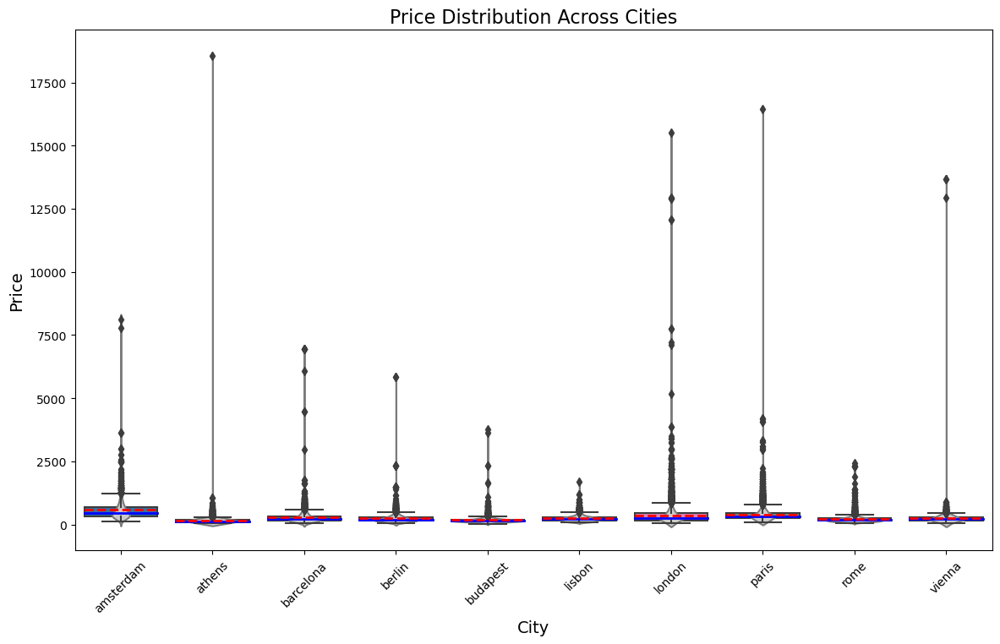

In [70]:
plt.figure(figsize=(14, 8))


sns.violinplot(x='city', y='price', data=df, inner=None, color=".8")

sns.boxplot(x='city', y='price', data=df, showmeans=True, meanline=True,
            meanprops={"color": "red", "linewidth": 2},
            medianprops={"color": "blue", "linewidth": 2})

# Customize the plot
plt.title('Price Distribution Across Cities', fontsize=16)
plt.xlabel('City', fontsize=14)
plt.ylabel('Price', fontsize=14)
plt.xticks(rotation=45)

# Show the plot
plt.show()

### It seems like that we need to handle the outliers of the price column, as they are very far from the rest of data points

## Outliers detection and handling

#### Price Feature

In [71]:
px.histogram(df['price'])

In [72]:
def detect_outliers(feature) :
    q1 = feature.quantile(0.25)
    q3 = feature.quantile(0.75)
    iqr = q3 - q1

    ol_range_up = q3 + 1.5 * iqr
    ol_range_down = q1 - 1.5 * iqr

    #ol_perc = len(df['price'][df['price'] > ol_range]) / len(df)
    return feature[(feature < ol_range_down) | (feature > ol_range_up)]


### Will remove the outliers from price feature as a whole and try to remove them for each city

In [73]:
## Overall outliers handling
df2 = df.copy()
price_ol = detect_outliers(df2['price'])

In [74]:
len(price_ol), len(df2)

(3662, 51707)

In [75]:
df2.drop(price_ol.index, inplace = True)

In [76]:
df2

,price,room_type,room_shared,room_private,person_capacity,is_superhost,multi_rooms,is_bis,cleanliness_rating,guest_satisfaction_overall,...,dist_centre,metro_dist,attr_index_norm,rest_index_norm,lng,lat,city,week_time,price_per_pers,distance_category
0,194.033698,Private room,False,True,2.0,False,1,0,10.0,93.0,...,5.022964,2.539380,4.166708,6.846473,4.90569,52.41772,amsterdam,weekdays,97.016849,"Metro far , Center far"
1,344.245776,Private room,False,True,4.0,False,0,0,8.0,85.0,...,0.488389,0.239404,33.421209,58.342928,4.90005,52.37432,amsterdam,weekdays,86.061444,"Metro near, Center near"
2,264.101422,Private room,False,True,2.0,False,0,1,9.0,87.0,...,5.748312,3.651621,3.985908,6.646700,4.97512,52.36103,amsterdam,weekdays,132.050711,"Metro far , Center far"
3,433.529398,Private room,False,True,4.0,False,0,1,9.0,90.0,...,0.384862,0.439876,26.119108,60.973565,4.89417,52.37663,amsterdam,weekdays,108.382349,"Metro near, Center near"
4,485.552926,Private room,False,True,2.0,True,0,0,10.0,98.0,...,0.544738,0.318693,29.272733,56.811677,4.90051,52.37508,amsterdam,weekdays,242.776463,"Metro near, Center near"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51697,463.501858,Entire home/apt,False,False,5.0,False,1,0,10.0,90.0,...,1.021878,0.285141,12.658020,6.850308,16.38297,48.20176,vienna,weekends,92.700372,"Metro near, Center near"
51700,115.933899,Private room,False,True,4.0,False,1,0,9.0,94.0,...,3.041932,0.308192,7.859670,5.039797,16.33970,48.19325,vienna,weekends,28.983475,"Metro near , Center far"
51703,304.793960,Entire home/apt,False,False,2.0,False,0,0,8.0,86.0,...,0.810205,0.100839,14.678608,8.270427,16.38070,48.20296,vienna,weekends,152.396980,"Metro near, Center near"
51705,301.054157,Private room,False,True,2.0,False,0,0,10.0,87.0,...,3.044100,0.287435,7.822803,3.832416,16.34100,48.19200,vienna,weekends,150.527079,"Metro near , Center far"


In [77]:
## handling outliers for each city based on its prices
df3 = df.copy()

In [78]:
def remove_outliers(df,feature) :
    Q1 = df[feature].quantile(0.25)
    Q3 = df[feature].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[feature] >= lower_bound) & (df[feature] <= upper_bound)]


In [79]:
df3 = df3.groupby('city').apply(lambda x: remove_outliers(x, 'price')).reset_index(drop=True)

C:\Users\Ahmed Barakat\AppData\Local\Temp\ipykernel_9900\2744787615.py:1: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [80]:
#Comparison between box blots for each case
fig1 = px.box(df, x='price', title='Boxplot of Price with outliers')
fig2 = px.box(df2, x='price', title='Boxplot of price without outliers (overall)')
fig3 = px.box(df3, x='price', title='Boxplot of price without outliers (by city)')

# Show the plots
figure = make_subplots(rows = 3, cols = 1, subplot_titles = ('Price with outliers', 'Price without outliers', 'price without outliers (by city)'))

figure.add_trace(fig1.data[0], row = 1, col = 1)
figure.add_trace(fig2.data[0], row = 2, col = 1)
figure.add_trace(fig3.data[0], row = 3, col = 1)

figure.show()

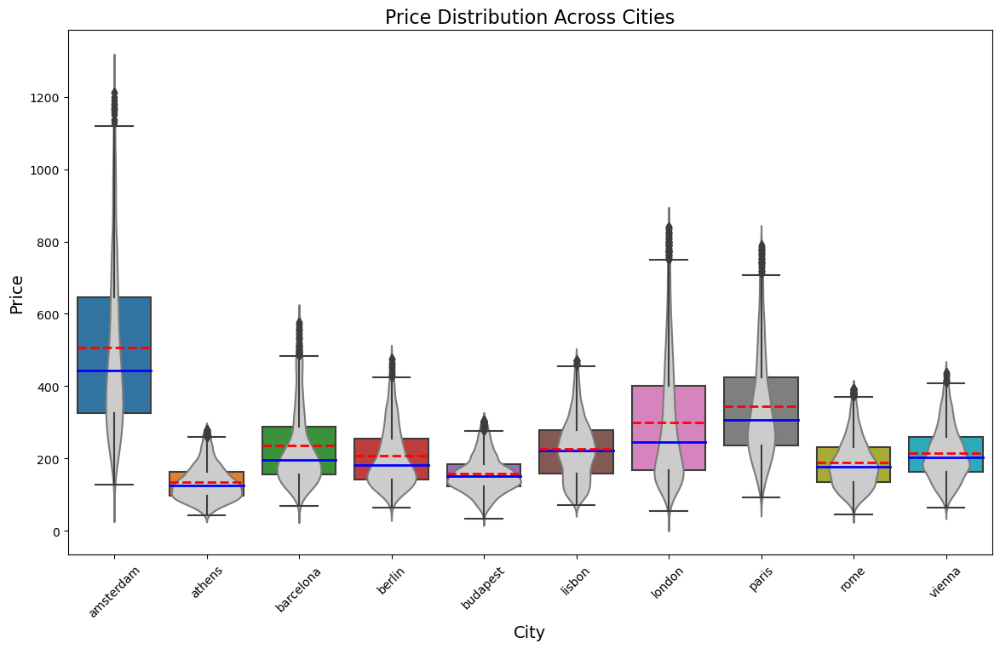

In [81]:
#Visualizing the price differnce between each city

plt.figure(figsize=(14, 8))


sns.violinplot(x='city', y='price', data=df3, inner=None, color=".8")

sns.boxplot(x='city', y='price', data=df3, showmeans=True, meanline=True,
            meanprops={"color": "red", "linewidth": 2},
            medianprops={"color": "blue", "linewidth": 2})

# Customize the plot
plt.title('Price Distribution Across Cities', fontsize=16)
plt.xlabel('City', fontsize=14)
plt.ylabel('Price', fontsize=14)
plt.xticks(rotation=45)

# Show the plot
plt.show()

In [82]:
#Comparison of mean between each city
pd.pivot_table(data = df3, index = ['city'], columns = ['week_time'], values = ['price'], aggfunc= 'mean' )

price            
week_time    weekdays    weekends
city                             
amsterdam  485.945196  530.948191
athens     134.168952  133.826463
barcelona  235.251610  236.152401
berlin     204.659194  209.327231
budapest   152.758818  163.364129
lisbon     225.013878  227.283368
london     297.390702  303.923437
paris      343.320599  343.819745
rome       185.009820  191.146884
vienna     212.562604  219.681019

In [83]:
def categorize_city_price(row, average):
    if row['price'] > average * 1.1:
        return 'High'
    elif row['price'] < average * 0.9:
        return 'Low'
    else: 
        return 'Average'

In [84]:
df3['price_cat_per_city'] = df3.apply(lambda row : categorize_city_price(row, city_avg_price[row['city']]), axis = 1)

<Axes: xlabel='price_cat_per_city', ylabel='price'>

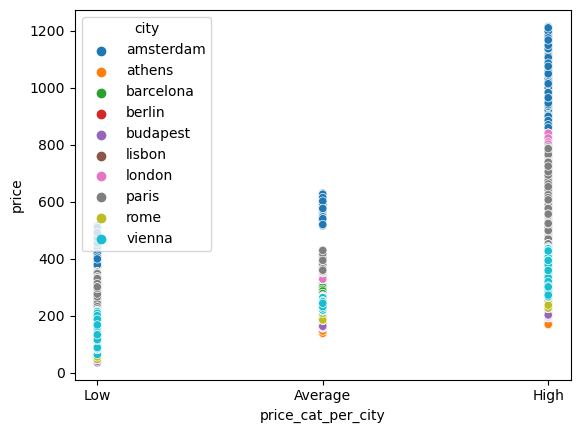

In [85]:
sns.scatterplot(data = df3 , x= 'price_cat_per_city', y='price', hue ='city')

It's shown that Amsterdam prices are significantly higher than the other cities

### We will use the -outliers handled by city- dataframe on the following steps, but we will try the performance of the machine learning models on the 3 dataframes to spot the effect of outliers on the target prediction

2- Correlation heatmaps: Generating the correlation matrix and plotting the correlation heatmap to specify the most correlated features that can be beneficial for machine learning models.

In [86]:
df_numerical = pd.get_dummies(df3)

In [87]:
df_numerical.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49001 entries, 0 to 49000
Data columns (total 39 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   price                                      49001 non-null  float64
 1   room_shared                                49001 non-null  bool   
 2   room_private                               49001 non-null  bool   
 3   person_capacity                            49001 non-null  float64
 4   is_superhost                               49001 non-null  bool   
 5   multi_rooms                                49001 non-null  int64  
 6   is_bis                                     49001 non-null  int64  
 7   cleanliness_rating                         49001 non-null  float64
 8   guest_satisfaction_overall                 49001 non-null  float64
 9   bedrooms                                   49001 non-null  int64  
 10  dist_centre           

In [88]:
correlation_with_price = df_numerical.corrwith(df_numerical['price'])
correlation_with_price[(correlation_with_price > 0.2) | (correlation_with_price < -0.2) ]

price                        1.000000
room_private                -0.274237
person_capacity              0.243999
attr_index_norm              0.418718
rest_index_norm              0.243212
lng                         -0.332238
lat                          0.372602
price_per_pers               0.753253
room_type_Entire home/apt    0.283812
room_type_Private room      -0.274237
city_amsterdam               0.367756
city_athens                 -0.254558
city_paris                   0.260229
price_cat_per_city_High      0.612459
price_cat_per_city_Low      -0.570026
dtype: float64

###
### Positive Correlated features with price:
    1- Person Capacity : Number of persons per listing
    2- attr_index_norm : How near from attractions
    3- rest_index_norm : How near from Restaurants
    4- city_amsterdam : Prices in amsterdam are higher
    5- city_paris : Prices in paris are higher than others except Amsterdam
    6- Entire home_apt 
   
### Negative Correlated features with price:
    1- Room Private : The private rooms are cheaper than the entire home
    2- city_athens : Prices in athens are lower than the other cities
    
### The features which are not mentioned are already a dependant features on price of the listing.
###

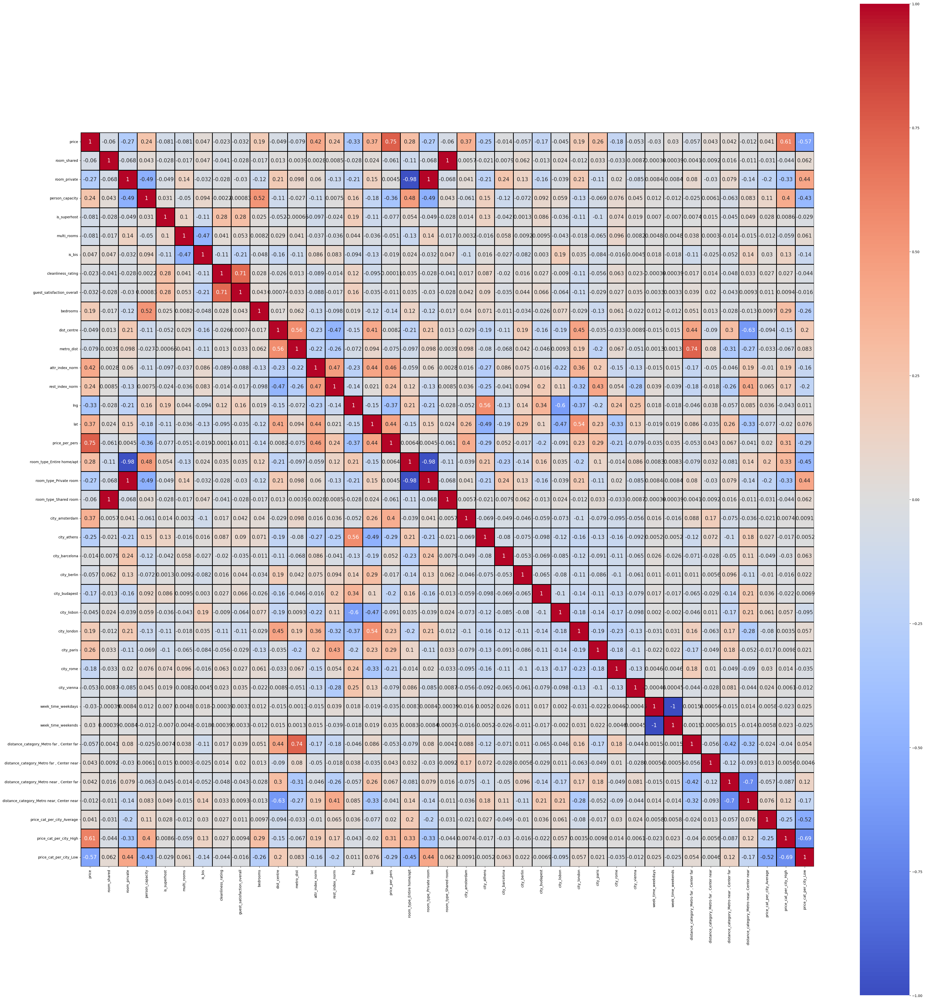

In [89]:
# Calculate the correlation matrix
corr_matrix = df_numerical.corr()

# Set a larger figure size to accommodate 40 features
plt.figure(figsize=(40, 40))  # Larger figure size for more space

# Create the heatmap with smaller annotations for better clarity
sns.heatmap(corr_matrix, annot=True, annot_kws={"size": 15}, cmap='coolwarm', linewidths=1, linecolor='black', square=True)

# Adjust the layout to prevent clipping of labels
plt.tight_layout()

# Show the plot
plt.show()

In [90]:
high_corr_matrix = corr_matrix[corr_matrix > 0.3]
# Remove self-correlations (correlation of a feature with itself)
high_corr_matrix = high_corr_matrix.where(np.triu(np.ones(high_corr_matrix.shape), k=1).astype(bool))
# Flatten the DataFrame, keep only non-null values
high_corr_pairs = high_corr_matrix.stack().reset_index()
high_corr_pairs.columns = ['Feature 1','Feature 2','Correlation']
high_corr_pairs

,Feature 1,Feature 2,Correlation
0,price,attr_index_norm,0.418718
1,price,lat,0.372602
2,price,price_per_pers,0.753253
3,price,city_amsterdam,0.367756
4,price,price_cat_per_city_High,0.612459
5,room_shared,room_type_Shared room,1.000000
6,room_private,room_type_Private room,1.000000
7,room_private,price_cat_per_city_Low,0.436207
8,person_capacity,bedrooms,0.521938
9,person_capacity,room_type_Entire home/apt,0.483991


### interesting features to visualize:
    1- Price with attr_index_norm
    2- Price with cities
    3- private room with low category of price per city
    4- person capacity with bedrooms and entire home apt and cat high of price
    5- cleaniless rating with guest satisfaction overall
    6- dist centre with metro dist
    7- attr_index_norm with rest_index_norm
    8- attr_index_norm and rest_index_norm with prices to show the distribution of listings based on these features.

## Uni and Bi-Variate Analysis:

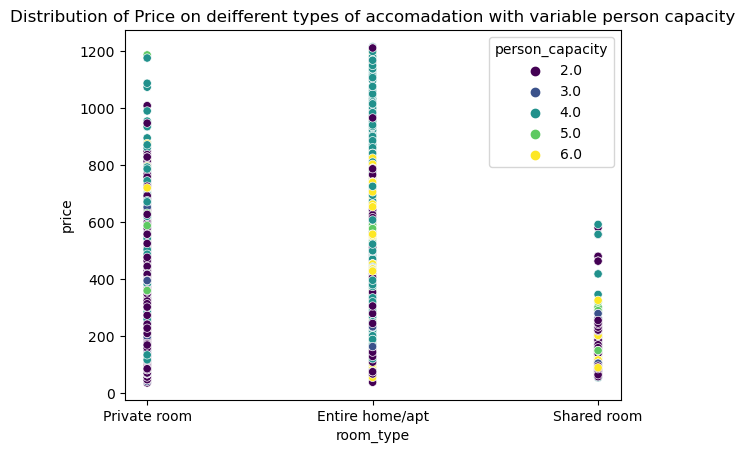

In [91]:
sns.scatterplot(data=df3, x=df3['room_type'], y=df3['price'], hue=df3['person_capacity'], palette='viridis')
plt.title('Distribution of Price on deifferent types of accomadation with variable person capacity')
plt.show()

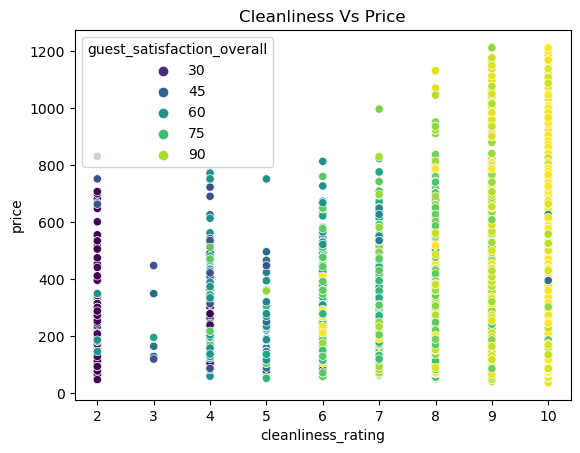

In [92]:
sns.scatterplot(data=df3, x=df3['cleanliness_rating'], y=df3['price'], hue=df3['guest_satisfaction_overall'], palette='viridis')
plt.title('Cleanliness Vs Price')
plt.show()

C:\Users\Ahmed Barakat\AppData\Local\Temp\ipykernel_9900\3589795292.py:1: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



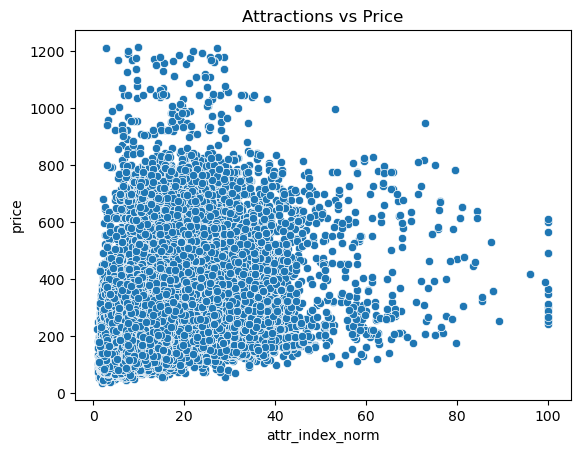

In [93]:
sns.scatterplot(data=df3, x=df3['attr_index_norm'], y=df3['price'], palette='viridis')
plt.title('Attractions vs Price')
plt.show()

C:\Users\Ahmed Barakat\AppData\Local\Temp\ipykernel_9900\1381230363.py:1: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



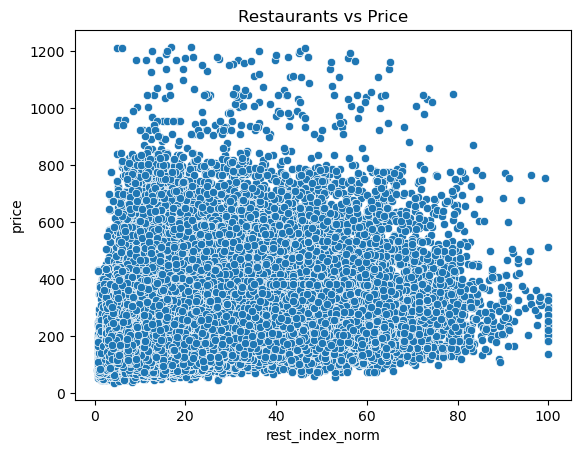

In [94]:
sns.scatterplot(data=df3, x=df3['rest_index_norm'], y=df3['price'], palette='viridis')
plt.title('Restaurants vs Price')
plt.show()

C:\Users\Ahmed Barakat\AppData\Local\Temp\ipykernel_9900\1621195473.py:1: FutureWarning:

Passing `palette` without assigning `hue` is deprecated.

C:\Users\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



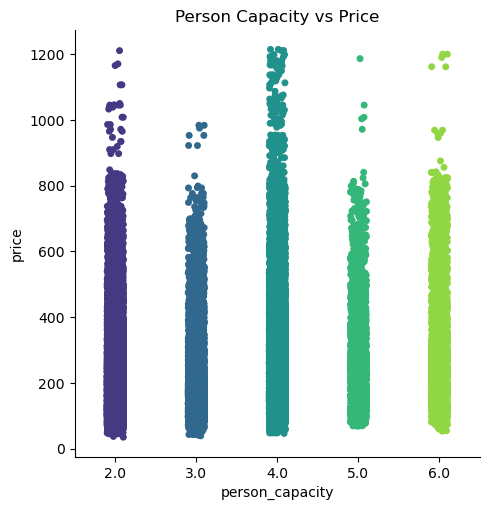

In [95]:
sns.catplot(data=df3, x=df3['person_capacity'], y=df3['price'], palette='viridis')
plt.title('Person Capacity vs Price')
plt.show()

C:\Users\Ahmed Barakat\AppData\Local\Temp\ipykernel_9900\778770039.py:1: FutureWarning:

Passing `palette` without assigning `hue` is deprecated.

C:\Users\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



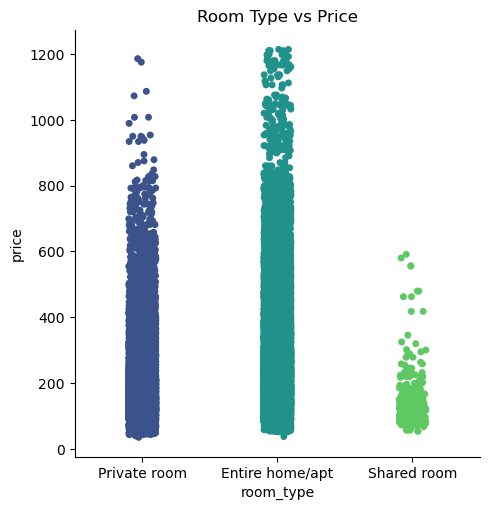

In [96]:
sns.catplot(data=df3, x=df3['room_type'], y=df3['price'], palette='viridis')
plt.title('Room Type vs Price')
plt.show()

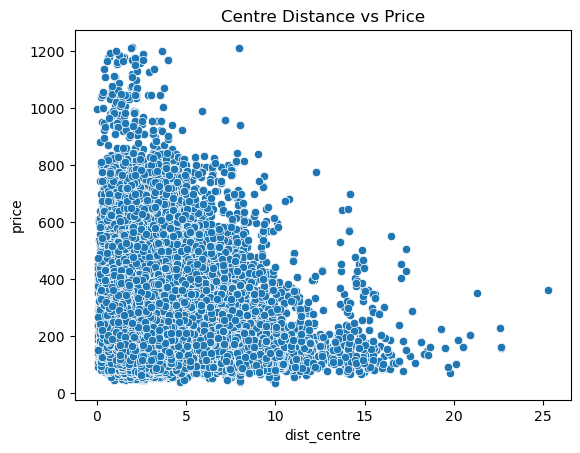

In [97]:
sns.scatterplot(data=df3, x=df3['dist_centre'], y=df3['price'])
plt.title('Centre Distance vs Price')
plt.show()

C:\Users\Ahmed Barakat\AppData\Local\Temp\ipykernel_9900\2293901190.py:1: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



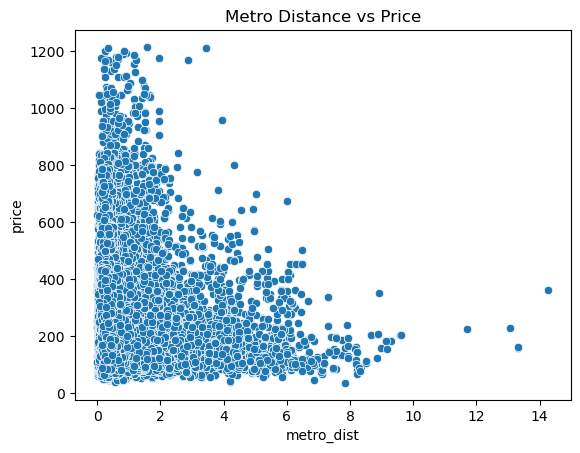

In [98]:
sns.scatterplot(data=df3, x=df3['metro_dist'], y=df3['price'], palette='viridis')
plt.title('Metro Distance vs Price')
plt.show()

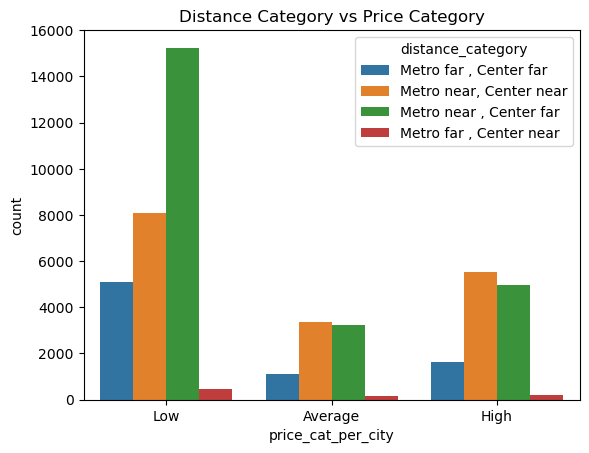

In [99]:
sns.countplot(data=df3, x=df3['price_cat_per_city'], hue=df3['distance_category'])
plt.title('Distance Category vs Price Category')
plt.show()

- Reasonable Insights

C:\Users\Ahmed Barakat\AppData\Local\Temp\ipykernel_9900\2717947324.py:1: FutureWarning:

Passing `palette` without assigning `hue` is deprecated.

C:\Users\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



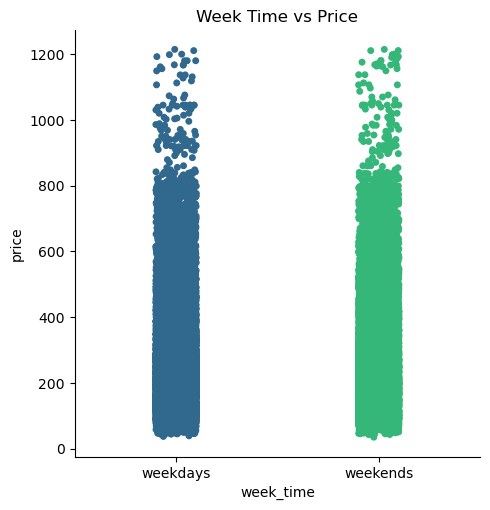

In [100]:
sns.catplot(data=df3, x=df3['week_time'], y=df3['price'], palette='viridis')
plt.title('Week Time vs Price')
plt.show()

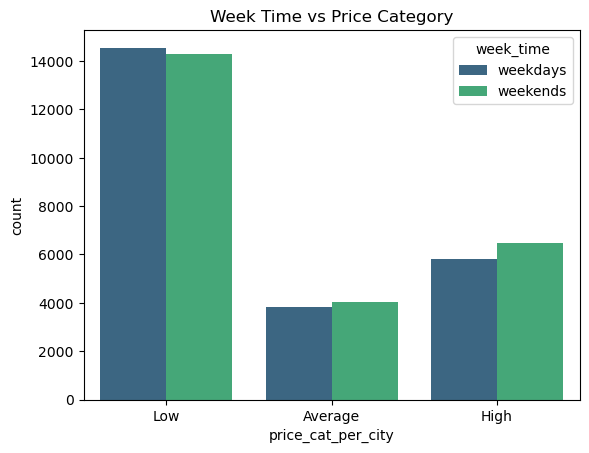

In [101]:
sns.countplot(data=df3, x=df3['price_cat_per_city'], hue=df3['week_time'], palette='viridis')
plt.title('Week Time vs Price Category')
plt.show()

- Slight differnce for high prices in weekend

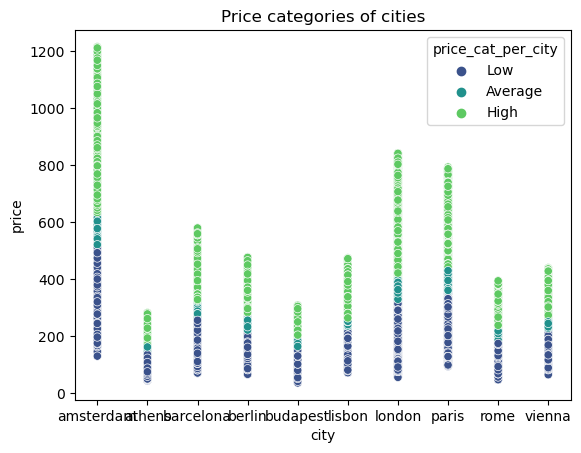

In [102]:
sns.scatterplot(data=df3, x=df3['city'], y=df3['price'], hue = df3['price_cat_per_city'] , palette='viridis')
plt.title('Price categories of cities')
plt.show()

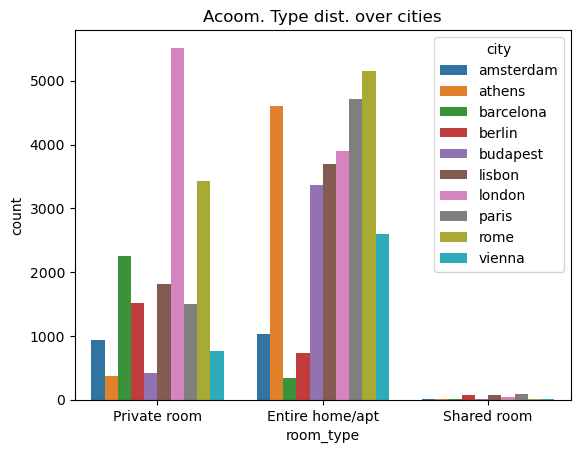

In [103]:
sns.countplot(data=df3, x='room_type', hue='city')
plt.title('Acoom. Type dist. over cities')
plt.show()

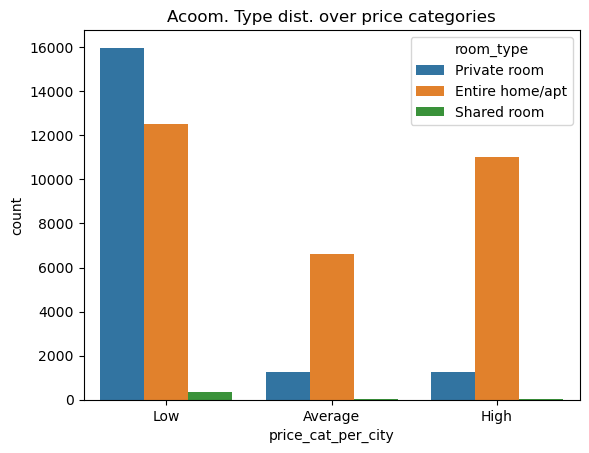

In [104]:
sns.countplot(data=df3, x='price_cat_per_city', hue='room_type')
plt.title('Acoom. Type dist. over price categories')
plt.show()

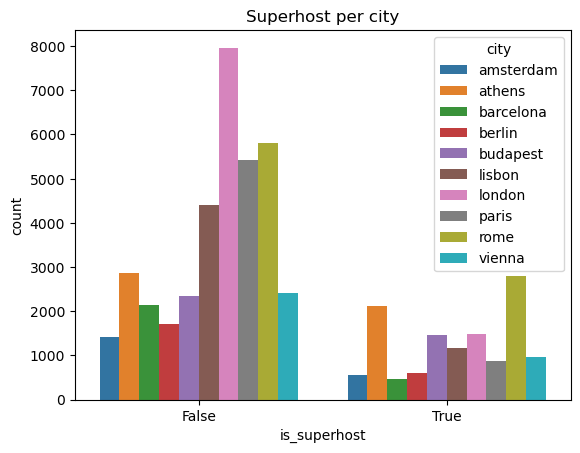

In [105]:
sns.countplot(data=df3, x='is_superhost', hue='city')
plt.title('Superhost per city')
plt.show()

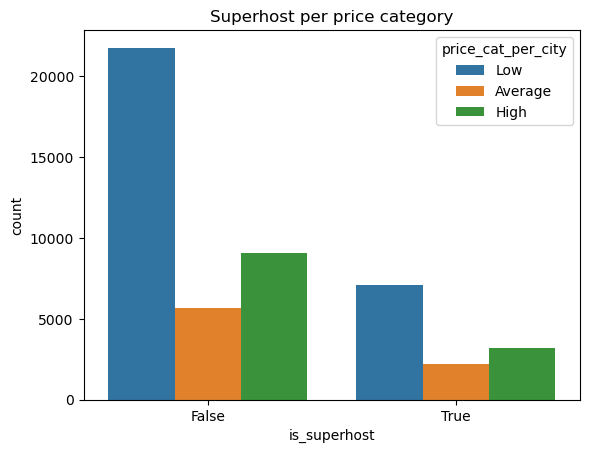

In [106]:
sns.countplot(data=df3, x='is_superhost', hue='price_cat_per_city')
plt.title('Superhost per price category')
plt.show()

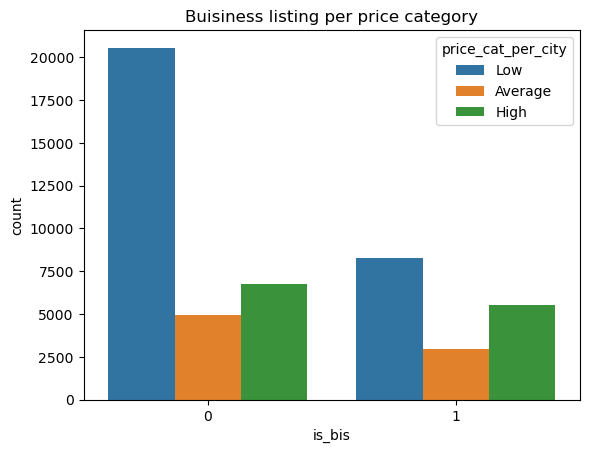

In [107]:
sns.countplot(data=df3, x='is_bis', hue='price_cat_per_city')
plt.title('Buisiness listing per price category')
plt.show()

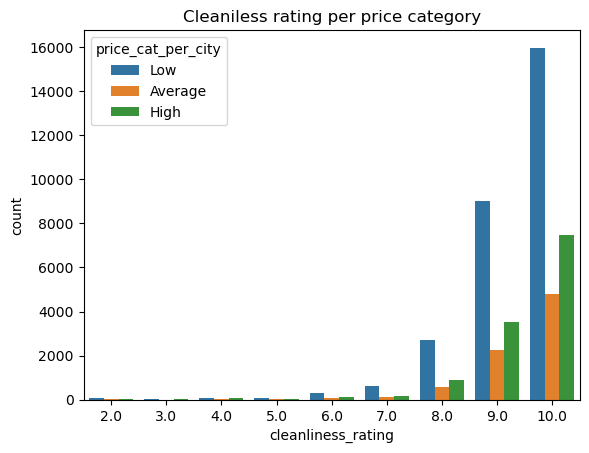

In [108]:
sns.countplot(data=df3, x='cleanliness_rating', hue='price_cat_per_city')
plt.title('Cleaniless rating per price category')
plt.show()

- You can get a clean listing for low price

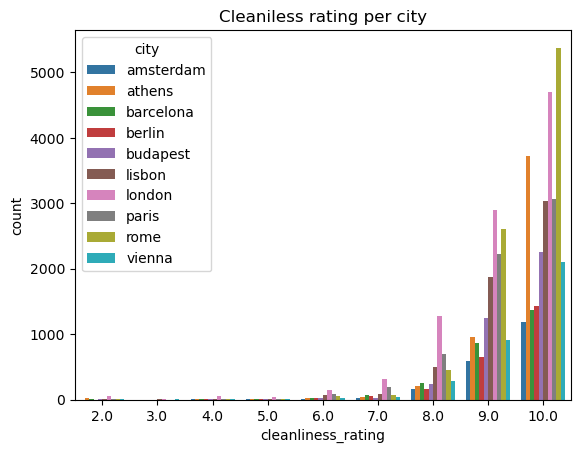

In [109]:
sns.countplot(data=df3, x='cleanliness_rating', hue='city')
plt.title('Cleaniless rating per city')
plt.show()

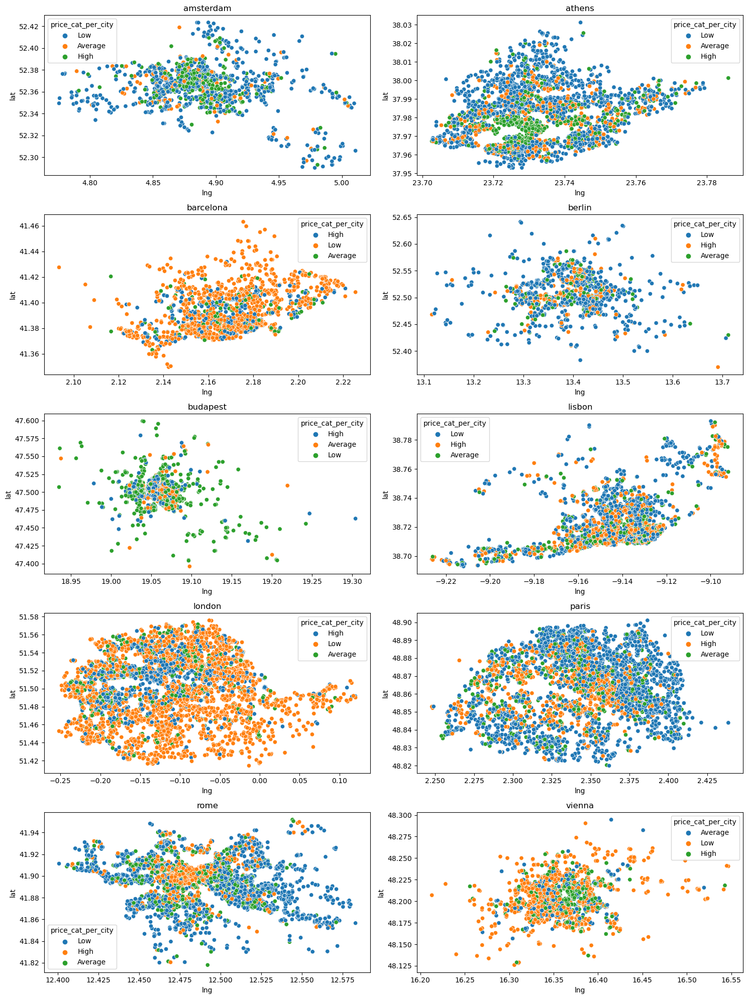

In [110]:
#Listings distribution and price categories over cities
fig, axes = plt.subplots(5, 2, figsize=(15, 20))

for i, (city, ax) in enumerate(zip(df3['city'].unique(), axes.flatten())):
    sns.scatterplot(data=df3[df3['city'] == city], x='lng', y='lat', hue='price_cat_per_city', ax=ax)
    ax.set_title(city)

plt.tight_layout()

plt.show()

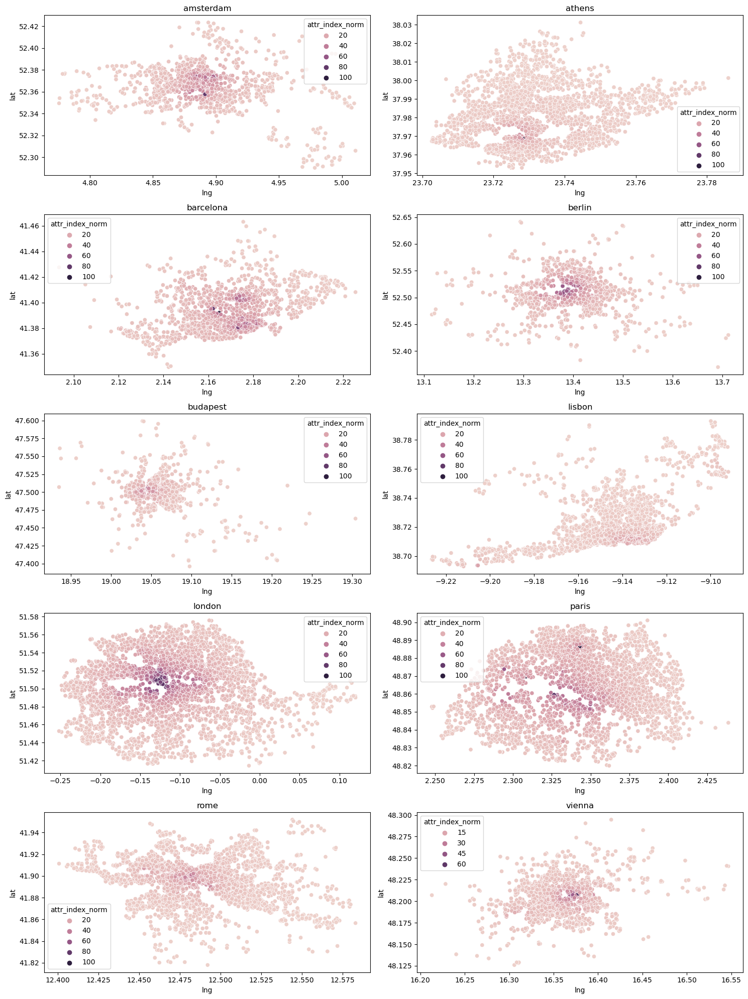

In [111]:
#Listings attractions index and price categories over cities

fig, axes = plt.subplots(5, 2, figsize=(15, 20))

for i, (city, ax) in enumerate(zip(df3['city'].unique(), axes.flatten())):
    sns.scatterplot(data=df3[df3['city'] == city], x='lng', y='lat', hue='attr_index_norm', ax=ax)
    ax.set_title(city)

plt.tight_layout()

plt.show()

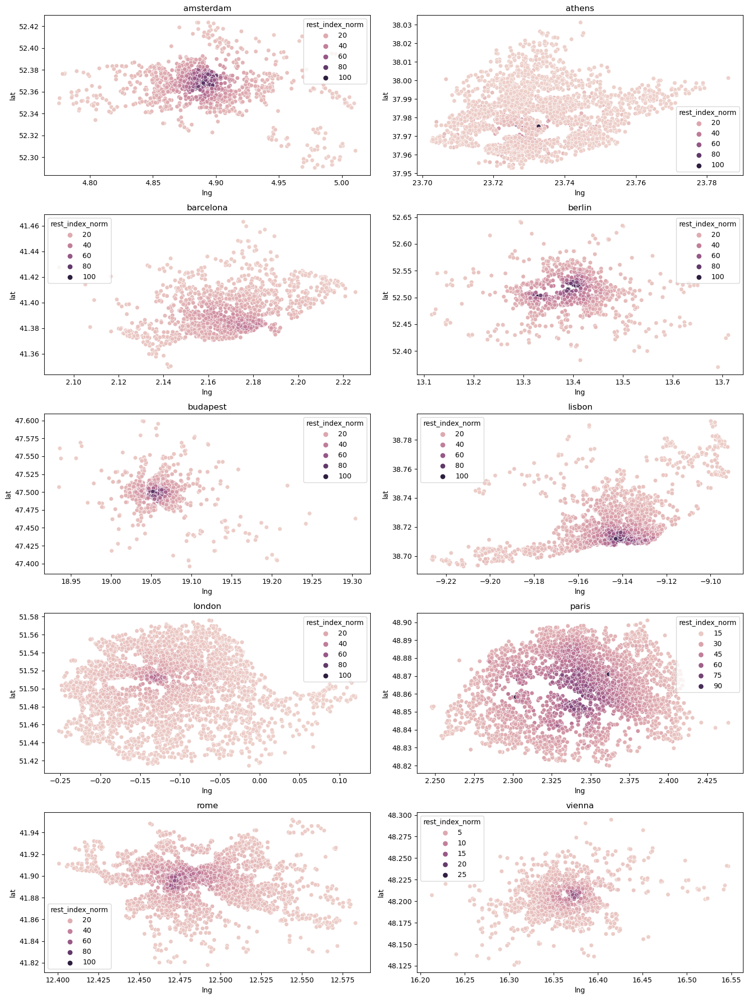

In [112]:
#Listings restaurants index and price categories over cities


fig, axes = plt.subplots(5, 2, figsize=(15, 20))

for i, (city, ax) in enumerate(zip(df3['city'].unique(), axes.flatten())):
    sns.scatterplot(data=df3[df3['city'] == city], x='lng', y='lat', hue='rest_index_norm', ax=ax)
    ax.set_title(city)

plt.tight_layout()

plt.show()

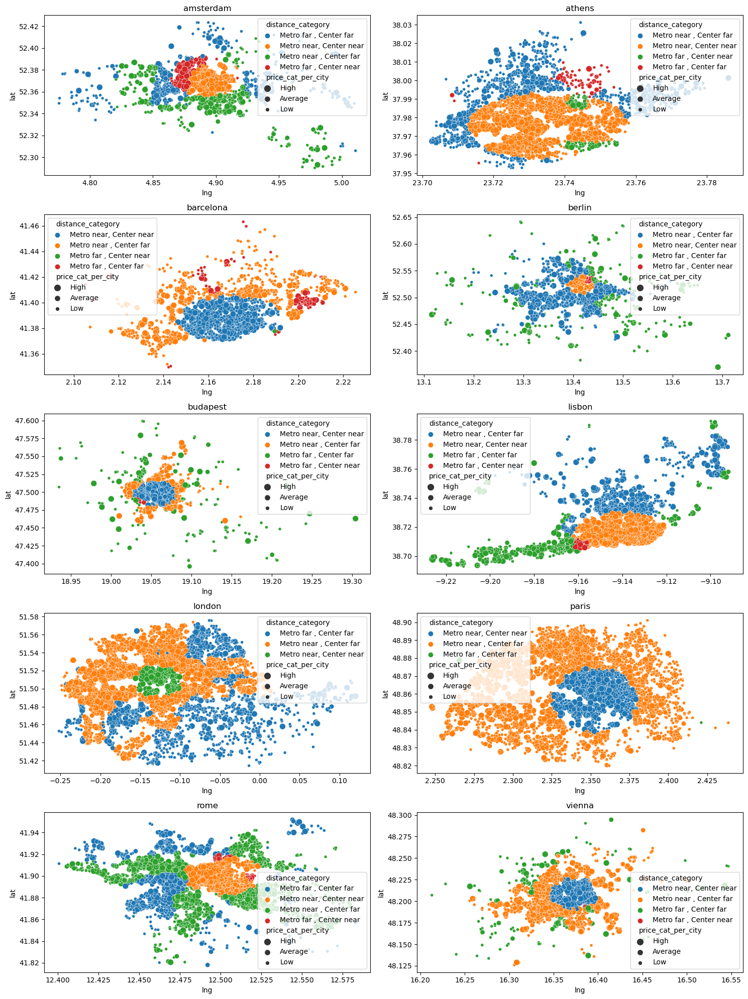

In [113]:
#Ditribution across cities showing price and distance categories

fig, axes = plt.subplots(5, 2, figsize=(15, 20))

for i, (city, ax) in enumerate(zip(df3['city'].unique(), axes.flatten())):
    sns.scatterplot(data=df3[df3['city'] == city], x='lng', y='lat', hue='distance_category', size = 'price_cat_per_city', size_order=['High','Average','Low'] , ax=ax)
    ax.set_title(city)

plt.tight_layout()

plt.show()

### Trying to understand attr_index and rest_index:

C:\Users\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



<Axes: xlabel='attr_index_norm', ylabel='Count'>

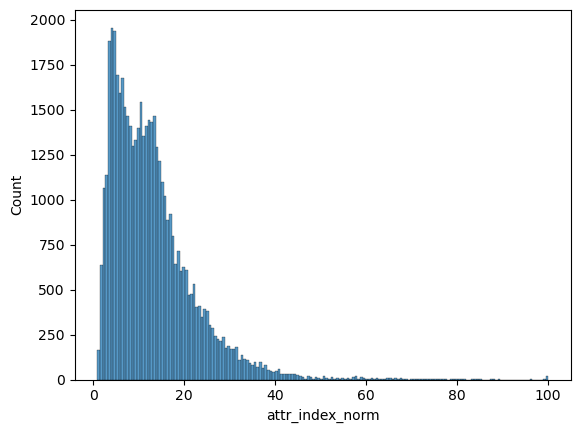

In [114]:
sns.histplot(data = df3 , x = df3['attr_index_norm'])

C:\Users\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



<Axes: xlabel='rest_index_norm', ylabel='Count'>

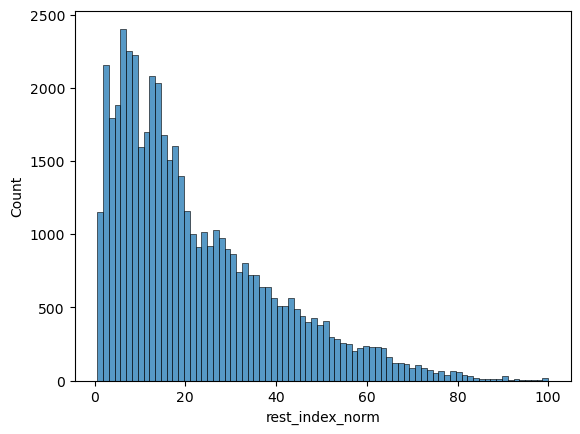

In [115]:
sns.histplot(data = df3 , x = df3['rest_index_norm'])

<Axes: xlabel='attr_index_norm', ylabel='dist_centre'>

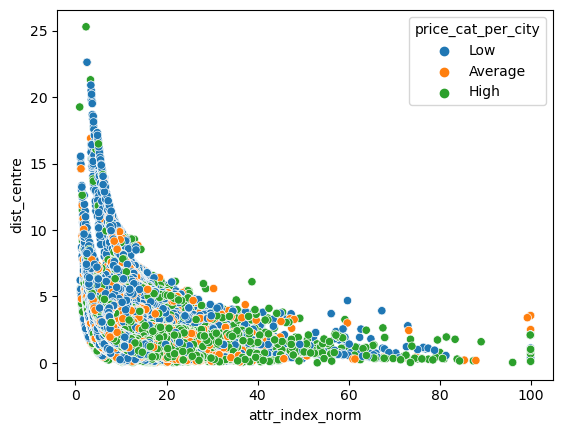

In [116]:
sns.scatterplot(data = df3 , x = df3['attr_index_norm'], y = df3['dist_centre'], hue=df3['price_cat_per_city'])

<Axes: xlabel='attr_index_norm', ylabel='metro_dist'>

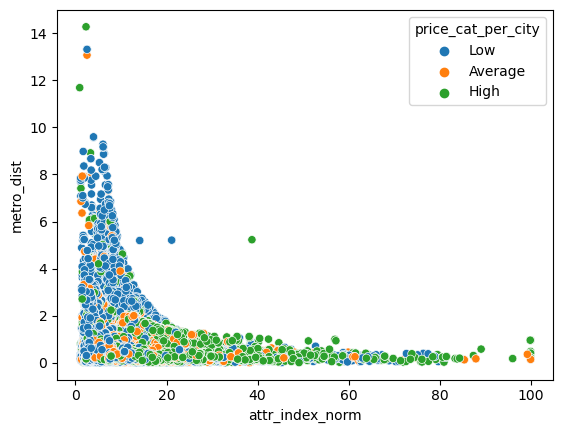

In [117]:
sns.scatterplot(data = df3 , x = df3['attr_index_norm'], y = df3['metro_dist'], hue=df3['price_cat_per_city'])

<Axes: xlabel='attr_index_norm', ylabel='dist_centre'>

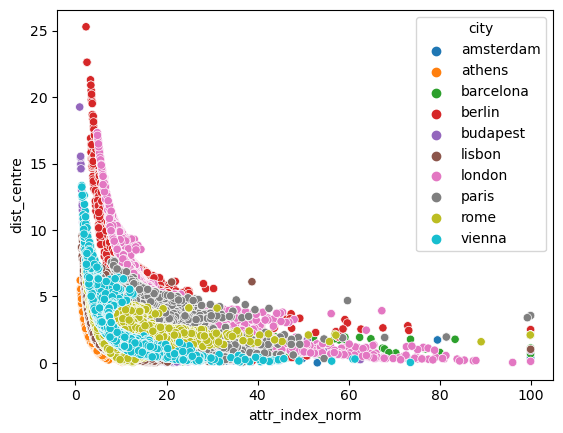

In [118]:
sns.scatterplot(data = df3 , x = df3['attr_index_norm'], y = df3['dist_centre'], hue=df3['city'])

### The more attr_norm, the nearer the city centre

<Axes: xlabel='rest_index_norm', ylabel='dist_centre'>

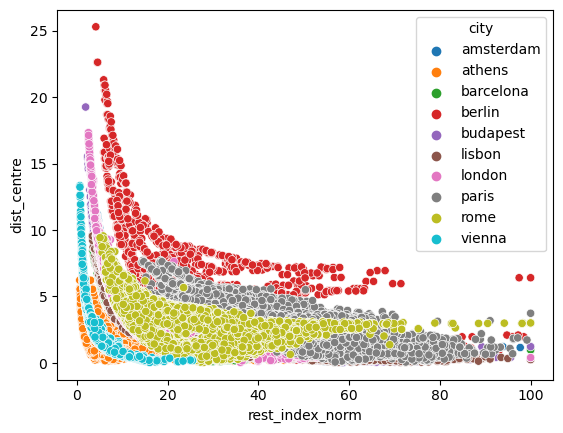

In [119]:
sns.scatterplot(data = df3 , x = df3['rest_index_norm'], y = df3['dist_centre'], hue=df3['city'])

### The more attr_norm, the nearer the restaurants

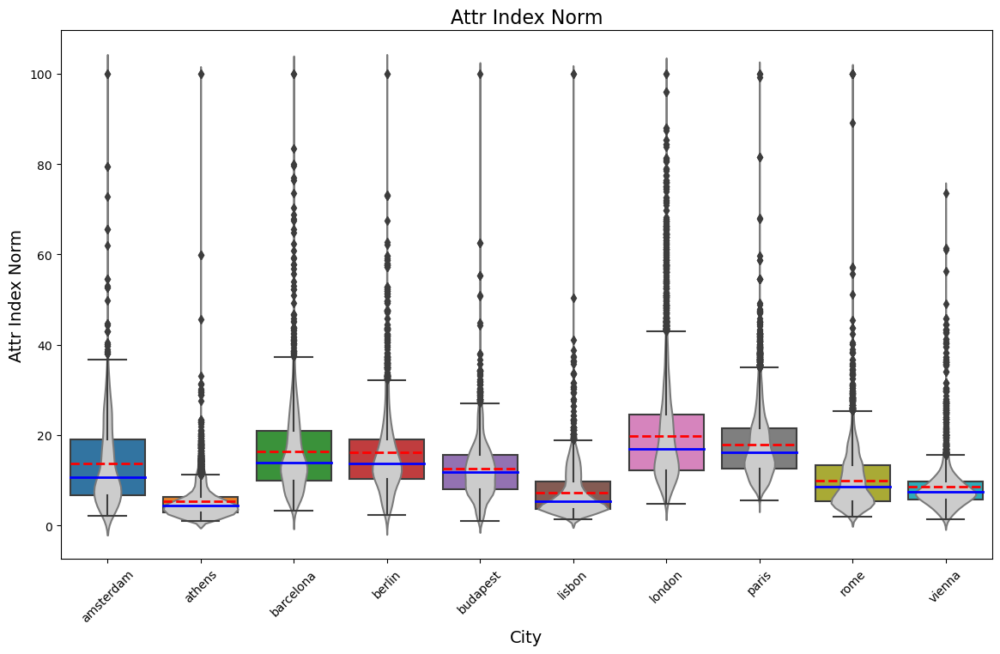

In [120]:
#Visualizing the attr_index_norm between each city

plt.figure(figsize=(14, 8))


sns.violinplot(x='city', y='attr_index_norm', data=df3, inner=None, color=".8")

sns.boxplot(x='city', y='attr_index_norm', data=df3, showmeans=True, meanline=True,
            meanprops={"color": "red", "linewidth": 2},
            medianprops={"color": "blue", "linewidth": 2})

# Customize the plot
plt.title('Attr Index Norm', fontsize=16)
plt.xlabel('City', fontsize=14)
plt.ylabel('Attr Index Norm', fontsize=14)
plt.xticks(rotation=45)

# Show the plot
plt.show()

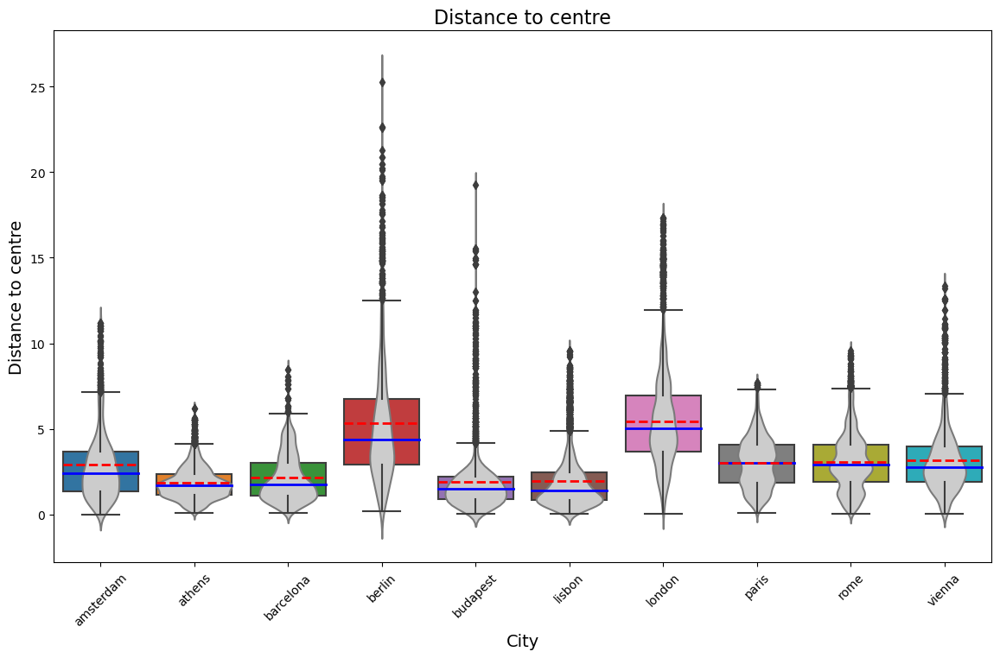

In [121]:
#Visualizing the price differnce between each city

plt.figure(figsize=(14, 8))


sns.violinplot(x='city', y='dist_centre', data=df3, inner=None, color=".8")

sns.boxplot(x='city', y='dist_centre', data=df3, showmeans=True, meanline=True,
            meanprops={"color": "red", "linewidth": 2},
            medianprops={"color": "blue", "linewidth": 2})

# Customize the plot
plt.title('Distance to centre', fontsize=16)
plt.xlabel('City', fontsize=14)
plt.ylabel('Distance to centre', fontsize=14)
plt.xticks(rotation=45)

# Show the plot
plt.show()

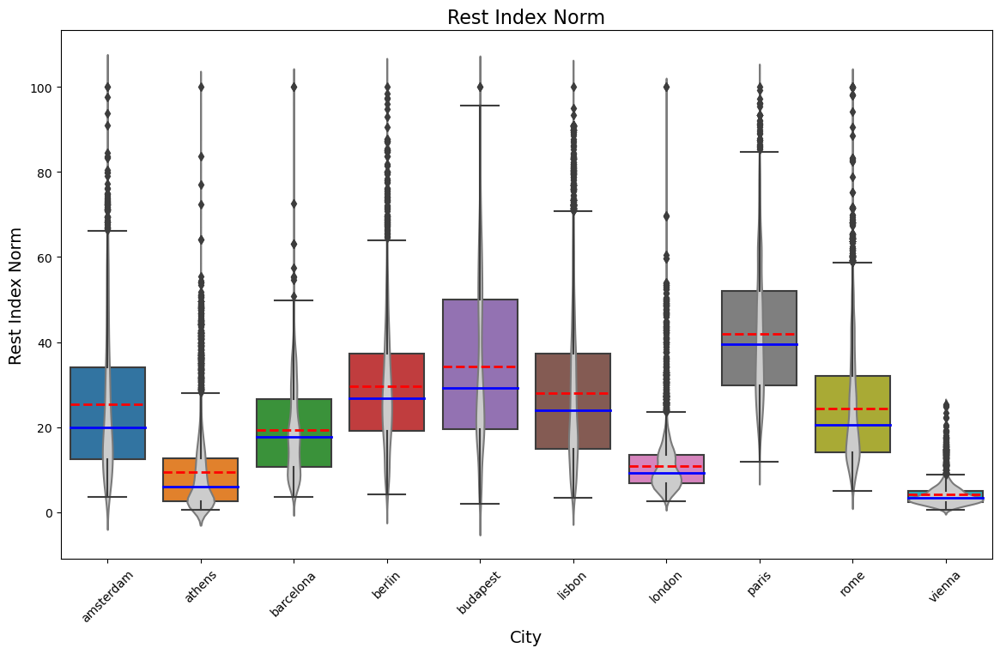

In [122]:
#Visualizing the rest_index_norm between each city

plt.figure(figsize=(14, 8))


sns.violinplot(x='city', y='rest_index_norm', data=df3, inner=None, color=".8")

sns.boxplot(x='city', y='rest_index_norm', data=df3, showmeans=True, meanline=True,
            meanprops={"color": "red", "linewidth": 2},
            medianprops={"color": "blue", "linewidth": 2})

# Customize the plot
plt.title('Rest Index Norm', fontsize=16)
plt.xlabel('City', fontsize=14)
plt.ylabel('Rest Index Norm', fontsize=14)
plt.xticks(rotation=45)

# Show the plot
plt.show()

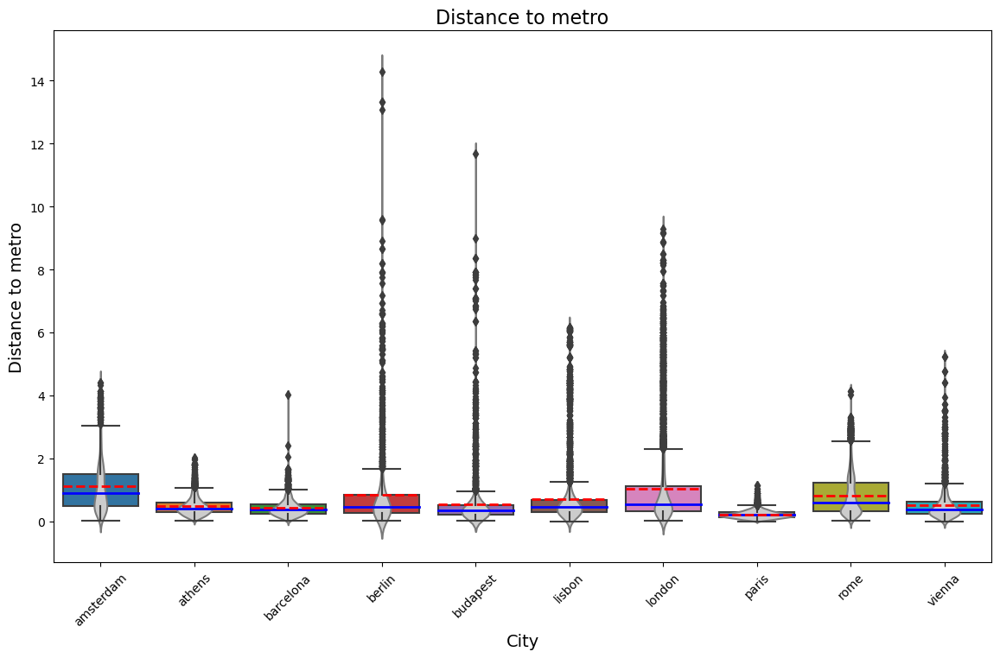

In [123]:
#Visualizing the metro distance between each city

plt.figure(figsize=(14, 8))


sns.violinplot(x='city', y='metro_dist', data=df3, inner=None, color=".8")

sns.boxplot(x='city', y='metro_dist', data=df3, showmeans=True, meanline=True,
            meanprops={"color": "red", "linewidth": 2},
            medianprops={"color": "blue", "linewidth": 2})

# Customize the plot
plt.title('Distance to metro', fontsize=16)
plt.xlabel('City', fontsize=14)
plt.ylabel('Distance to metro', fontsize=14)
plt.xticks(rotation=45)

# Show the plot
plt.show()

# Regression Modelling:

In [124]:
df_n = df3.copy()
df_n.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49001 entries, 0 to 49000
Data columns (total 22 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   price                       49001 non-null  float64
 1   room_type                   49001 non-null  object 
 2   room_shared                 49001 non-null  bool   
 3   room_private                49001 non-null  bool   
 4   person_capacity             49001 non-null  float64
 5   is_superhost                49001 non-null  bool   
 6   multi_rooms                 49001 non-null  int64  
 7   is_bis                      49001 non-null  int64  
 8   cleanliness_rating          49001 non-null  float64
 9   guest_satisfaction_overall  49001 non-null  float64
 10  bedrooms                    49001 non-null  int64  
 11  dist_centre                 49001 non-null  float64
 12  metro_dist                  49001 non-null  float64
 13  attr_index_norm             490

In [125]:
df_n.drop(columns = ['room_shared','room_private','attr_index_norm','rest_index_norm','price_per_pers','distance_category','price_cat_per_city','multi_rooms','is_bis'], inplace = True)

In [126]:
#Handling object columns
df_n['room_type'] = df_n['room_type'].map({
  'Private room' : 2, 'Entire home/apt' : 3, 'Shared room' : 1  })
df_n['week_time'] = df_n['week_time'].map({'weekdays' : 1 , 'weekends' : 2})
df_n = pd.get_dummies(df_n)

In [127]:
df_n.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49001 entries, 0 to 49000
Data columns (total 22 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   price                       49001 non-null  float64
 1   room_type                   49001 non-null  int64  
 2   person_capacity             49001 non-null  float64
 3   is_superhost                49001 non-null  bool   
 4   cleanliness_rating          49001 non-null  float64
 5   guest_satisfaction_overall  49001 non-null  float64
 6   bedrooms                    49001 non-null  int64  
 7   dist_centre                 49001 non-null  float64
 8   metro_dist                  49001 non-null  float64
 9   lng                         49001 non-null  float64
 10  lat                         49001 non-null  float64
 11  week_time                   49001 non-null  int64  
 12  city_amsterdam              49001 non-null  bool   
 13  city_athens                 490

In [128]:
X = df_n.drop(columns =['price'])
y = df_n['price']

In [129]:
X, y = shuffle(X, y, random_state=42) #To shuffle cities data

## Features have been selected after trying several compinations and evaluating regression modles performance accordingly.

In [130]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import Lasso
from xgboost import XGBRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import cross_validate, cross_val_predict
from sklearn.model_selection import GridSearchCV , RandomizedSearchCV
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_error , mean_squared_error ,r2_score
from sklearn.pipeline import Pipeline
from sklearn.model_selection import KFold
from sklearn.compose import ColumnTransformer


In [131]:
x_train , x_test , y_train, y_test = train_test_split(X, y , test_size= 0.2, random_state= 42)

In [132]:
features_to_scale_train = x_train[['dist_centre','metro_dist','lng','lat']]
features_not_to_scale_train = x_train[['room_type', 'person_capacity', 'cleanliness_rating','is_superhost', 'week_time','city_athens', 'city_barcelona', 'city_berlin', 'city_budapest', 'city_lisbon','city_rome','city_vienna','city_amsterdam',
          'city_london','city_paris']]

features_to_scale_test = x_test[['dist_centre','metro_dist','lng','lat']]
features_not_to_scale_test = x_test[['room_type', 'person_capacity', 'cleanliness_rating','is_superhost', 'week_time','city_athens', 'city_barcelona', 'city_berlin', 'city_budapest', 'city_lisbon','city_rome','city_vienna','city_amsterdam',
          'city_london','city_paris']]

In [133]:
scaler = StandardScaler()

# Fit the scaler on the train set and transform it
scaled_features_train = scaler.fit_transform(features_to_scale_train)
scaled_features_train_df = pd.DataFrame(scaled_features_train, columns=features_to_scale_train.columns, index=x_train.index)

# Combine scaled and non-scaled features for train set
x_train_sca = pd.concat([scaled_features_train_df, features_not_to_scale_train], axis=1)

# Transform the test set using the same scaler
scaled_features_test = scaler.transform(features_to_scale_test)
scaled_features_test_df = pd.DataFrame(scaled_features_test, columns=features_to_scale_test.columns, index=x_test.index)

# Combine scaled and non-scaled features for test set
x_test_sca = pd.concat([scaled_features_test_df, features_not_to_scale_test], axis=1)




In [134]:
LR = LinearRegression()
poly = PolynomialFeatures(3)
LS = Lasso()
RDGE = Ridge()
DT = DecisionTreeRegressor()
RF = RandomForestRegressor()
KN = KNeighborsRegressor()
XG = XGBRegressor()


models = {
    'Linear Regression' : LR,
    'Ploynomial Fit' : poly,
    'Lasso Regression' : LS,
    'Ridge Regression' : RDGE,
    'Decision Tree' : DT,
    'Random Forest' : RF,
    'KNN Regressor' : KN,
    'XGBoost Regressor' : XG
}

params = {
    'Random Forest' : { 'n_estimators' : [40, 30, 50, 60] , 'max_leaf_nodes' : [280, 320, 240], 'max_depth' : [40, 60, 30, 80]},
    'Decision Tree' : { 'max_depth' : [110, 150, 80, 100] , 'max_leaf_nodes' : [350, 300, 500, 200],  'min_samples_split' : [50 , 70, 100]},
    'XGBoost Regressor' : { 'learning_rate' : [0.005, 0.01] , 'n_estimators' : [1500, 1800, 2100] , 'max_depth' : [7, 9, 11] , 'min_child_weight' : [9], 'subsample' : [0.5], 'colsample_bytree' : [0.55], 'gamma' : [0.5, 0.8]},
    'KNN Regressor' : {'n_neighbors' : [15, 25, 35, 10]}
}

results = []

In [135]:
def Train_model(modelname, model, params):
    if isinstance(model, (LinearRegression, Lasso, Ridge, KNeighborsRegressor)):
        scalar = StandardScaler()
        x_train_sca = scalar.fit_transform(x_train)
        x_test_sca = scalar.transform(x_test)
        print(f'Training {modelname}..')
        model.fit(x_train_sca, y_train)
        y_pred = model.predict(x_test_sca)
        y_pred_train = model.predict(x_train_sca)
        results = {
            'Model Name': modelname,
            'Model R2 Score - Test' : r2_score(y_test, y_pred),
            'Model R2 Score - Train' : r2_score(y_train, y_pred_train),
            'MAE' : mean_absolute_error(y_test, y_pred),
            'MSE' : mean_squared_error(y_test, y_pred),
            'Best Hyperparameters' : None            
        } 
        return results

    elif isinstance(model, (PolynomialFeatures)):
        scalar = StandardScaler()
        x_train_sca = scalar.fit_transform(x_train)
        x_test_sca = scalar.transform(x_test)
        xp_train = model.fit_transform(x_train_sca)
        xp_test = model.transform(x_test_sca)
        model = LinearRegression()
        print(f'Training {modelname}..')
        model.fit(xp_train, y_train)
        y_pred = model.predict(xp_test)
        y_pred_train = model.predict(xp_train)

        results = {
            'Model Name': modelname,
            'Model R2 Score - Test' : r2_score(y_test, y_pred),
            'Model R2 Score - Train' : r2_score(y_train, y_pred_train),
            'MAE' : mean_absolute_error(y_test, y_pred),
            'MSE' : mean_squared_error(y_test, y_pred),
            'Best Hyperparameters' : None            
        }
        
        return results


    else :
        RS = RandomizedSearchCV(model , params[modelname], n_iter = 10, return_train_score= True, cv = 5)
        print(f'Excuting Randomized Search for {modelname}..')
        RS.fit(x_train, y_train)
        best_model = RS.best_estimator_
        best_params = RS.best_params_

        y_pred = best_model.predict(x_test)
        y_pred_train = best_model.predict(x_train)

        results = {
            'Model Name': modelname,
            'Model R2 Score - Test' : r2_score(y_test, y_pred),
            'Model R2 Score - Train' : r2_score(y_train, y_pred_train),
            'MAE' : mean_absolute_error(y_test, y_pred),
            'MSE' : mean_squared_error(y_test, y_pred),
            'Best Hyperparameters' : best_params           
        }
        
        return results


In [136]:
models

{'Linear Regression': LinearRegression(),
 'Ploynomial Fit': PolynomialFeatures(degree=3),
 'Lasso Regression': Lasso(),
 'Ridge Regression': Ridge(),
 'Decision Tree': DecisionTreeRegressor(),
 'Random Forest': RandomForestRegressor(),
 'KNN Regressor': KNeighborsRegressor(),
 'XGBoost Regressor': XGBRegressor(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
     

In [137]:
results = []

### Linear Regression :

In [138]:
result = Train_model('Linear Regression', LinearRegression(), params)
print(result)
results.append(result)

Training Linear Regression..
{'Model Name': 'Linear Regression', 'Model R2 Score - Test': 0.6137335737303466, 'Model R2 Score - Train': 0.602436052599362, 'MAE': 66.30771167415618, 'MSE': 8613.891535804305, 'Best Hyperparameters': None}


### Polynomial Regression:

In [139]:
result = Train_model('Polynomial Features', PolynomialFeatures(3), params)
print(result)
results.append(result)

Training Polynomial Features..
{'Model Name': 'Polynomial Features', 'Model R2 Score - Test': 0.7474978504165753, 'Model R2 Score - Train': 0.752202532268006, 'MAE': 51.32914822688158, 'MSE': 5630.896140972563, 'Best Hyperparameters': None}


### Lasso Regression :

In [140]:
result = Train_model('Lasso Regression', Lasso(), params)
print(result)
results.append(result)

Training Lasso Regression..
{'Model Name': 'Lasso Regression', 'Model R2 Score - Test': 0.6082423995450028, 'Model R2 Score - Train': 0.5957734351046076, 'MAE': 66.4489366457911, 'MSE': 8736.346855811176, 'Best Hyperparameters': None}


### Ridge Regression :

In [141]:
result = Train_model('Ridge Regression', Ridge(), params)
print(result)
results.append(result)

Training Ridge Regression..
{'Model Name': 'Ridge Regression', 'Model R2 Score - Test': 0.6119734186459677, 'Model R2 Score - Train': 0.5991751787634634, 'MAE': 66.48330099517042, 'MSE': 8653.143678760294, 'Best Hyperparameters': None}


### Decision Tree Regressor :

In [142]:
result = Train_model('Decision Tree', DecisionTreeRegressor(), params)
print(result)
results.append(result)

Excuting Randomized Search for Decision Tree..
{'Model Name': 'Decision Tree', 'Model R2 Score - Test': 0.742465608974306, 'Model R2 Score - Train': 0.7863893473777055, 'MAE': 51.31302212863031, 'MSE': 5743.117082316884, 'Best Hyperparameters': {'min_samples_split': 70, 'max_leaf_nodes': 500, 'max_depth': 100}}


### Random Forest Regressor:

In [143]:
result = Train_model('Random Forest', RandomForestRegressor(), params)
print(result)
results.append(result)

Excuting Randomized Search for Random Forest..
{'Model Name': 'Random Forest', 'Model R2 Score - Test': 0.7727162242564237, 'Model R2 Score - Train': 0.8070803790005714, 'MAE': 49.818259125063655, 'MSE': 5068.516596201641, 'Best Hyperparameters': {'n_estimators': 60, 'max_leaf_nodes': 320, 'max_depth': 80}}


### XGBoost Regressor:

In [144]:
result = Train_model('XGBoost Regressor', XGBRegressor(), params)
print(result)
results.append(result)

Excuting Randomized Search for XGBoost Regressor..
{'Model Name': 'XGBoost Regressor', 'Model R2 Score - Test': 0.8306320814825428, 'Model R2 Score - Train': 0.9239428061416409, 'MAE': 41.29376211043818, 'MSE': 3776.970454936319, 'Best Hyperparameters': {'subsample': 0.5, 'n_estimators': 1800, 'min_child_weight': 9, 'max_depth': 11, 'learning_rate': 0.01, 'gamma': 0.5, 'colsample_bytree': 0.55}}


### KNN Regressor:

In [145]:
result = Train_model('KNN Regressor', KNeighborsRegressor(25), params)
print(result)
results.append(result)

Training KNN Regressor..
{'Model Name': 'KNN Regressor', 'Model R2 Score - Test': 0.7081952997876263, 'Model R2 Score - Train': 0.7181678526679734, 'MAE': 55.60906323310255, 'MSE': 6507.358305877062, 'Best Hyperparameters': None}


In [146]:
results

[{'Model Name': 'Linear Regression',
  'Model R2 Score - Test': 0.6137335737303466,
  'Model R2 Score - Train': 0.602436052599362,
  'MAE': 66.30771167415618,
  'MSE': 8613.891535804305,
  'Best Hyperparameters': None},
 {'Model Name': 'Polynomial Features',
  'Model R2 Score - Test': 0.7474978504165753,
  'Model R2 Score - Train': 0.752202532268006,
  'MAE': 51.32914822688158,
  'MSE': 5630.896140972563,
  'Best Hyperparameters': None},
 {'Model Name': 'Lasso Regression',
  'Model R2 Score - Test': 0.6082423995450028,
  'Model R2 Score - Train': 0.5957734351046076,
  'MAE': 66.4489366457911,
  'MSE': 8736.346855811176,
  'Best Hyperparameters': None},
 {'Model Name': 'Ridge Regression',
  'Model R2 Score - Test': 0.6119734186459677,
  'Model R2 Score - Train': 0.5991751787634634,
  'MAE': 66.48330099517042,
  'MSE': 8653.143678760294,
  'Best Hyperparameters': None},
 {'Model Name': 'Decision Tree',
  'Model R2 Score - Test': 0.742465608974306,
  'Model R2 Score - Train': 0.7863893473

In [134]:
results = [{'Model Name': 'Linear Regression',
  'Model R2 Score - Test': 0.6137335737303466,
  'Model R2 Score - Train': 0.602436052599362,
  'MAE': 66.30771167415618,
  'MSE': 8613.891535804305,
  'Best Hyperparameters': None},
 {'Model Name': 'Polynomial Features',
  'Model R2 Score - Test': 0.7474978504165753,
  'Model R2 Score - Train': 0.752202532268006,
  'MAE': 51.32914822688158,
  'MSE': 5630.896140972563,
  'Best Hyperparameters': None},
 {'Model Name': 'Lasso Regression',
  'Model R2 Score - Test': 0.6082423995450028,
  'Model R2 Score - Train': 0.5957734351046076,
  'MAE': 66.4489366457911,
  'MSE': 8736.346855811176,
  'Best Hyperparameters': None},
 {'Model Name': 'Ridge Regression',
  'Model R2 Score - Test': 0.6119734186459677,
  'Model R2 Score - Train': 0.5991751787634634,
  'MAE': 66.48330099517042,
  'MSE': 8653.143678760294,
  'Best Hyperparameters': None},
 {'Model Name': 'Decision Tree',
  'Model R2 Score - Test': 0.7453679229327785,
  'Model R2 Score - Train': 0.7945115689719093,
  'MAE': 51.13094221169727,
  'MSE': 5678.394352250563,
  'Best Hyperparameters': {'min_samples_split': 50,
   'max_leaf_nodes': 500,
   'max_depth': 110}},
 {'Model Name': 'Random Forest',
  'Model R2 Score - Test': 0.772593753767659,
  'Model R2 Score - Train': 0.8071364703562329,
  'MAE': 49.833596743170126,
  'MSE': 5071.247735733348,
  'Best Hyperparameters': {'n_estimators': 50,
   'max_leaf_nodes': 320,
   'max_depth': 40}},
 {'Model Name': 'XGBoost Regressor',
  'Model R2 Score - Test': 0.8341723014454527,
  'Model R2 Score - Train': 0.9322488025971263,
  'MAE': 40.78023333678737,
  'MSE': 3698.022172871266,
  'Best Hyperparameters': {'subsample': 0.5,
   'n_estimators': 2100,
   'min_child_weight': 9,
   'max_depth': 11,
   'learning_rate': 0.01,
   'gamma': 0.8,
   'colsample_bytree': 0.55}},
 {'Model Name': 'KNN Regressor',
  'Model R2 Score - Test': 0.7081952997876263,
  'Model R2 Score - Train': 0.7181678526679734,
  'MAE': 55.60906323310255,
  'MSE': 6507.358305877062,
  'Best Hyperparameters': None}]

### Results Dataframe:

In [147]:
#Results Dataframe
results_df = pd.DataFrame(results)
results_df

,Model Name,Model R2 Score - Test,Model R2 Score - Train,MAE,MSE,Best Hyperparameters
0,Linear Regression,0.613734,0.602436,66.307712,8613.891536,None
1,Polynomial Features,0.747498,0.752203,51.329148,5630.896141,None
2,Lasso Regression,0.608242,0.595773,66.448937,8736.346856,None
3,Ridge Regression,0.611973,0.599175,66.483301,8653.143679,None
4,Decision Tree,0.742466,0.786389,51.313022,5743.117082,"{'min_samples_split': 70, 'max_leaf_nodes': 50..."
5,Random Forest,0.772716,0.807080,49.818259,5068.516596,"{'n_estimators': 60, 'max_leaf_nodes': 320, 'm..."
6,XGBoost Regressor,0.830632,0.923943,41.293762,3776.970455,"{'subsample': 0.5, 'n_estimators': 1800, 'min_..."
7,KNN Regressor,0.708195,0.718168,55.609063,6507.358306,None


### XGBoost seems to be the best model but it's a bit overfitted, so we will tune the model manually until we reach the best model with overfitting

In [148]:
XGBoost_best_params = results_df[results_df['Model Name'] == 'XGBoost Regressor']['Best Hyperparameters']
XGBoost_best_params[6]

{'subsample': 0.5,
 'n_estimators': 1800,
 'min_child_weight': 9,
 'max_depth': 11,
 'learning_rate': 0.01,
 'gamma': 0.5,
 'colsample_bytree': 0.55}

### Manually Tuned XGBoost:

In [149]:
XG = XGBRegressor(
    subsample = 0.5,
    n_estimators = 2100,
    min_child_weight = 9,
    max_depth = 7,
    learning_rate = 0.0038,
    gamma = 0.8,
    colsample_bytree = 0.55,
    random_state = 42)

XG.fit(x_train, y_train)

y_pred = XG.predict(x_test)
y_pred_train = XG.predict(x_train)

result = pd.DataFrame([{
    'Model R2 Score - Test': r2_score(y_test, y_pred),
    'Model R2 Score - Train': r2_score(y_train, y_pred_train),
    'MAE': mean_absolute_error(y_test, y_pred),
    'MSE': mean_squared_error(y_test, y_pred)
}], index = ['Manually Tuned XGBoost Regressor'])


result


,Model R2 Score - Test,Model R2 Score - Train,MAE,MSE
Manually Tuned XGBoost Regressor,0.781753,0.804838,47.729942,4866.993383


In [150]:
# Validating the model with cross validation

cv_results = cross_validate(XG, x_train, y_train , cv = 5, return_train_score = True)

print("Cross-validation results:")
print(f"Train R2 scores:\n {cv_results['train_score']}")
print(f"Test R2 scores:\n {cv_results['test_score']}\n")

print(f"Average Train R2 score:\n {cv_results['train_score'].mean()}")
print(f"Average Test R2 score:\n {cv_results['test_score'].mean()}")

Cross-validation results:
Train R2 scores:
 [0.80944811 0.80758945 0.80653577 0.80725831 0.80911224]
Test R2 scores:
 [0.76095262 0.77171003 0.76719378 0.77103893 0.76247486]

Average Train R2 score:
 0.8079887777435515
Average Test R2 score:
 0.7666740456749472


### Model seems to be fairly fitted

# PCA 

<BarContainer object of 8 artists>

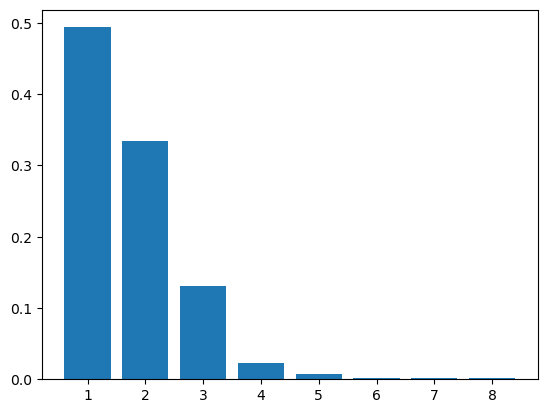

In [151]:
#PCA
pca = PCA()
pca.fit(x_train)
plt.bar(x=range(1, 9), height=pca.explained_variance_ratio_[:8])

In [152]:
pca = PCA(5)
x_train_pca = pca.fit_transform(x_train)
x_test_pca = pca.transform(x_test)

In [153]:
LR = LinearRegression()

LR.fit(x_train_pca, y_train)

score = LR.score(x_test_pca, y_test)
score

0.41671543967183033

In [154]:
poly = PolynomialFeatures(degree=3)

xp_train = poly.fit_transform(x_train_pca)

xp_test = poly.transform(x_test_pca)  

LR = LinearRegression()

LR.fit(xp_train, y_train)

y_predict = LR.predict(xp_test)

score = LR.score(xp_test, y_test)
score

0.6221435653343603

In [155]:
XG_PCA = XGBRegressor(
    subsample = 0.5,
    n_estimators = 2100,
    min_child_weight = 9,
    max_depth = 8,
    learning_rate = 0.00382,
    gamma = 0.5,
    colsample_bytree = 0.5,
    random_state = 42
)

XG_PCA.fit(x_train_pca,y_train)

score_test = XG_PCA.score(x_test_pca, y_test)
score_train = XG_PCA.score(x_train_pca, y_train)

print(f'XGB Regressor Model test score = {round(score_test*100, 2)} %\nXGB Regressor Model train score = {round(score_train*100, 2)} %')

XGB Regressor Model test score = 71.33 %
XGB Regressor Model train score = 74.64 %


### PCA Doesn't give improved score, even the score is lower!

# Model Export for Deployment:

In [201]:
import joblib 

In [207]:
joblib.dump(XG, 'XGB_model.pkl')

['XGB_model.pkl']

## Producing Metro Data for Deployment:

In [168]:
# Define the Overpass API endpoint
overpass_url = "http://overpass-api.de/api/interpreter"

# Function to get metro stations for a given city
def get_metro_stations(city_name, bbox):
    # Overpass API query
    overpass_query = f"""
    [out:json];
    node["railway"="station"]["station"="subway"]({bbox});
    out body;
    """
    response = requests.get(overpass_url, params={'data': overpass_query})
    data = response.json()
    
    # Extract relevant data
    stations = []
    for element in data['elements']:
        lat = element['lat']
        lon = element['lon']
        name = element['tags'].get('name', 'Unknown')
        stations.append({'city': city_name, 'name': name, 'lat': lat, 'lon': lon})
    
    return stations

# Define bounding boxes for each city (format: south,west,north,east)
city_bboxes = {
    'amsterdam': '52.2782,4.7280,52.4312,5.0792',
    'athens': '37.9030,23.6322,38.0548,23.7991',
    'barcelona': '41.3200,2.0669,41.4489,2.2288',
    'berlin': '52.3993,13.0464,52.5920,13.7809',
    'budapest': '47.4176,18.9736,47.5615,19.1756',
    'lisbon': '38.6881,-9.2308,38.7968,-9.0838',
    'london': '51.4456,-0.2396,51.5654,0.0832',
    'paris': '48.8071,2.2254,48.9021,2.4283',
    'rome': '41.7998,12.3676,41.9646,12.5849',
    'vienna': '48.1300,16.2128,48.3224,16.5209'
}

# Fetch metro stations for all cities
all_stations = []
for city, bbox in city_bboxes.items():
    stations = get_metro_stations(city, bbox)
    all_stations.extend(stations)

# Create a DataFrame
df_metro_stations = pd.DataFrame(all_stations)

In [169]:
df_metro_stations.to_csv('metro_stations.csv')

In [170]:
df_metro_stations

,city,name,lat,lon
0,amsterdam,Amstelveenseweg,52.338403,4.857577
1,amsterdam,Jan van Galenstraat,52.372658,4.835294
2,amsterdam,Van der Madeweg,52.329448,4.930519
3,amsterdam,Overamstel,52.331732,4.917627
4,amsterdam,De Vlugtlaan,52.379613,4.838222
...,...,...,...,...
1062,vienna,Karlsplatz,48.200979,16.369312
1063,vienna,Schottenring,48.216545,16.371968
1064,vienna,Volkstheater,48.205705,16.359254
1065,vienna,Schwedenplatz,48.211791,16.377652


In [289]:
df3.to_csv('df3.csv')